In [1]:
using QuantumToolbox
using PlotlyJS
using FFTW
using OrdinaryDiffEq
using LinearAlgebra

In this notebook we play around with the cat-transmon system and simulate it both with and without the rotating wave approximation.

In [1]:
# function to plot the wigner function
function plot_wigner(rho,xx,yy)
    layout = Layout(
        xaxis_title="Re(β)",
        yaxis_title="Im(β)",
        title="Wigner function",
        width=500,
        height=500
    )
    
    w = wigner(rho, xx, yy);
    vbound = maximum(abs.(w))

    custom_colorscale = [
        [0, "blue"],   # Negative values to blue
        [0.5, "white"],  # Zero values to white
        [1, "red"],     # Positive values to red
    ]

    heatmap_trace = heatmap(
        z=w,
        x=xx,
        y=yy,
        colorscale=custom_colorscale,
        showscale=true,
        zmin = -vbound,
        zmax = vbound
    )

    plot(heatmap_trace, layout)
end;

# Initial tests


## Free transmon Hamiltonian

In [16]:
# make transmon hamiltonian
function get_free_transmon_hamiltonian(N::Int, EC::Real, EJ::Real; cutoff::Int=1)
    a = destroy(N)
    ad = create(N)

    n0 = (EJ/4/EC)^(1/4)
    nt = n0 * 1im * (ad - a) / sqrt(2)
    φt = 1/n0 * (ad + a) / sqrt(2)

    # H = -sqrt(EJ*EC) * (ad - a)^2 - EJ * sum((-1)^n / factorial(2*n) * ((EC/EJ)^(1/4)*(ad + a))^(2*n) for n in 0:cutoff)
    H = 4*EC*nt^2 - EJ * sum((-1)^n / factorial(2*n) * (φt)^(2*n) for n in 0:cutoff)
    return H
end;

In [17]:
result = eigen(get_free_transmon_hamiltonian(30, 1.0, 1.0; cutoff=1));

The uneven spacing near the end is a finite-sized effect. 

First, we will do some simulations without the rotating wave approximation. For example, the Fourier-transformed correlation function $\langle a^{\dagger} a \rangle (\omega)$ as a function of frequency.

In [18]:
N = 30
EC = 10.0
EJ = 1.0
# initial transmon state is vacuum
ψ0 = basis(N, 0)

# time evolution using mesolve
tlist = 0:1000:1000
result = mesolve(get_free_transmon_hamiltonian(N, EC, EJ; cutoff=1), ψ0, tlist, [], e_ops=[num(N)])

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 14s (ETA: 0h 00m 00s)


Solution of time evolution
(return code: Success)
--------------------------
num_states = 1
num_expect = 1
ODE alg.: OrdinaryDiffEqTsit5.Tsit5{typeof(OrdinaryDiffEqCore.trivial_limiter!), typeof(OrdinaryDiffEqCore.trivial_limiter!), Static.False}(OrdinaryDiffEqCore.trivial_limiter!, OrdinaryDiffEqCore.trivial_limiter!, static(false))
abstol = 1.0e-8
reltol = 1.0e-6


The higher the cutoff, the more and faster rotating terms there are. So the time evolution takes longer, but the system is more accurate.

In [19]:
result.expect[end]

0.0030800897089813773 + 1.606570292837987e-15im

## Simple 3-level system

We begin by looking at a simple three-level system, first without a drive, in order to compare it to the paradigmatic qubit system. The energy difference between the first two levels will be $\omega_q = 3 * 2\pi$ and between the second and third $2.31 * \omega_q$, for instance.

In [78]:
# dimension of resonator/cavity
N = 20 

# energy scales
ωq = 3 * 2π
ωr = 2 * 2π
Δ = ωq - ωr
g = 1. # full coupling constant in capacitive coupling
χ = g^2/Δ # coupling constant after unitary tranformation, i.e. in dispersive regime.

# hilbert space is ordered such that (cavity ⊗ qutrit)
# cavity mode
a = destroy(N) ⊗ qeye(3)
nc = a' * a # number operator
xc = a + a' # dipole operator

# qutrit mode
b = qeye(N) ⊗ destroy(3)
nq = b' * b # number operator
xq = b + b' # dipole operator
ω0, ω1, ω2 = .0, ωq, 2.31*ωq # non-linear energy levels, last jump is completely arbitrary

# identity operator
I = qeye(N) ⊗ qeye(3)

# full (non-dispersive) hamiltonian
H_qutrit = qeye(N) ⊗ QuantumObject(diagm([ω0, ω1, ω2]))
H_cavity = ωr * a' * a
H_coupling = g * (a' + a) * (b' + b)


# # other optional parameters
# κ = 0.01
# ϵd = 0.15*0
# ωd = 1.6
# κ2 = 1*0 # no cat for now
# α = 2

# time-independent hamiltonian
H3 = H_qutrit + H_cavity + H_coupling;

# operators to measure
e_ops = [nc, nq, a];

# # drive
# function H_drive(p, t)
#     # time-dependent coefficient of the drive
#     ϵd, ωd = p.ϵd, p.ωd
#     H = ϵd * sin(ωd * t)
#     return H
# end 

# # make time-dependent liouvillian
# op = ((H_static, (a'+a, H_drive)));

3-element Vector{QuantumObject{SparseMatrixCSC{ComplexF64, Int64}, OperatorQuantumObject, 2}}:
 Quantum Object:   type=Operator   dims=[20, 3]   size=(60, 60)   ishermitian=true
60×60 SparseMatrixCSC{ComplexF64, Int64} with 57 stored entries:
⎡⠀⢀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎤
⎢⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⠀⠀⎥
⎣⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠑⢄⎦
 Quantum Object:   type=Operator   dims=[20, 3]   size=(60, 60)   ishermitian=true
60×60 SparseMatrixCSC{ComplexF64, Int64} with 40 stored entries:
⎡⠐⠄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎤
⎢⠀⠀⠑⢀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠁⢄⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⠀⎥
⎢⠀⠀⠀⠀⠀⠀⠐⠄⠀⠀⠀⠀⠀⠀

In [79]:
# initial state is ground state of H_static
# eigensystem = eigen(H_static)
# ψ0 = Qobj(eigensystem.vectors[:,1], dims=(3,10));

ψ0 =  coherent(N, 2) ⊗ normalize!(fock(3, 1)+fock(3, 0));

In [81]:
# run mesolve
tlist = 0:0.01:250;
result = mesolve(H3, ψ0, tlist, [], e_ops=e_ops, saveat=tlist);

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 19s (ETA: 0h 00m 00s)


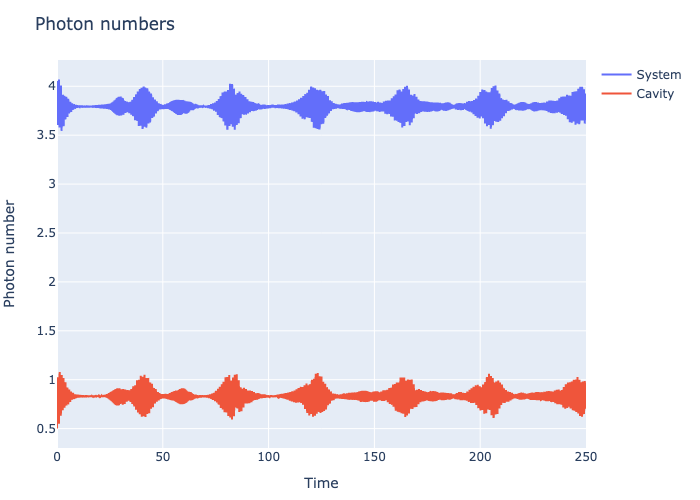

In [115]:
# plot the photon numbers
num_t_plot = scatter(x=tlist, y=real(result.expect[1,:]), name="System")
num_r_plot = scatter(x=tlist, y=real(result.expect[2,:]), name="Cavity")

layout = Layout(
    xaxis_title="Time",
    yaxis_title="Photon number",
    title="Photon numbers",
    width=1000,
    height=500
)



plot([num_t_plot, num_r_plot], layout)

The oscillations are due to the additional off-resonant terms in the coupling. In the simple RWA, the lines are exactly straight.

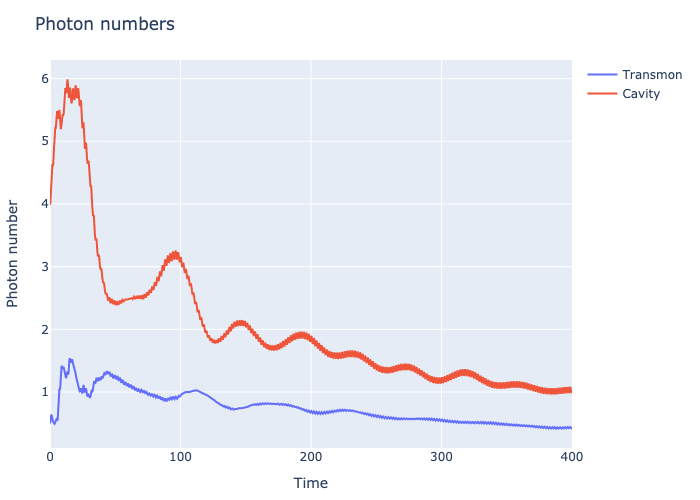

In [59]:
# plot with previous params and time-dependent drive

# plot the photon numbers
num_t_plot = scatter(x=tlist, y=real(result.expect[1,:]), name="Transmon")
num_r_plot = scatter(x=tlist, y=real(result.expect[2,:]), name="Cavity")

layout = Layout(
    xaxis_title="Time",
    yaxis_title="Photon number",
    title="Photon numbers",
    width=1000,
    height=500
)

plot([num_t_plot, num_r_plot], layout)

Note the inital occupation numbers $|\alpha|^2 = 4$ for the resonator and $1/2$ for the system, due to its superposition of $0$ and $1$ states.

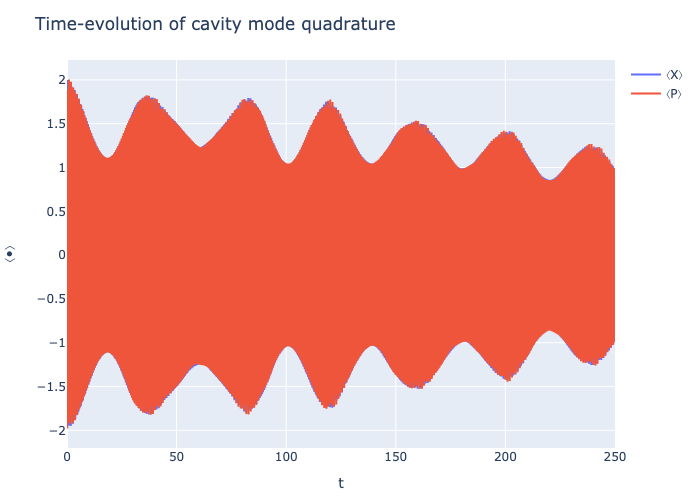

In [101]:
# time-evolution of cavity mode quadrature
# plot the expectations value as a function of time
X_plot = scatter(x=tlist, y=real(result.expect)[3,:], name="⟨X⟩")
P_plot = scatter(x=tlist, y=imag(result.expect)[3,:], name="⟨P⟩")

# make appropriate layout
layout = Layout(
    yaxis_title="⟨•⟩",
    xaxis_title="t",
    title="Time-evolution of cavity mode quadrature",
    width=1000,
    height=500
)

plot([X_plot, P_plot], layout)

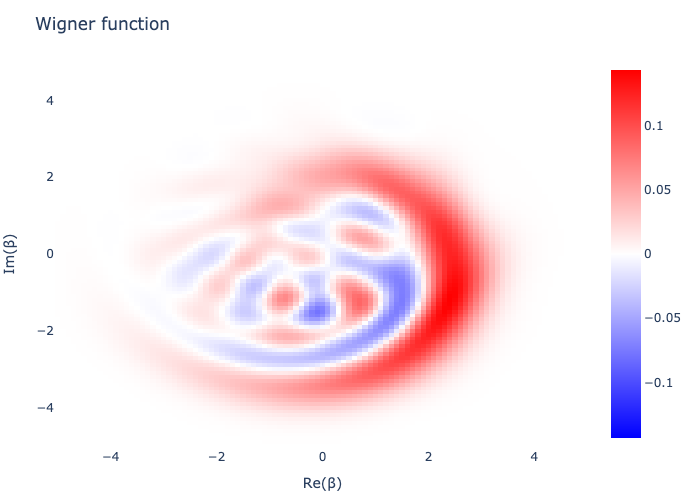

In [89]:
ψ_check = result.states[end]

ρ_r = ptrace(ψ_check, 1)

xvec = -5:0.1:5
plot_wigner(ρ_r, xvec, xvec)

We can see that the state of the resonator, initially a coherent state at $\alpha = 2$, has shifted in phase space after interacting dispersively with the transmon. 

Without the drive, it goes to a much uglier state.

Take a look at the correlation functions.

In [102]:
corr_r = correlation_2op_1t(H3, ψ0, tlist, a, a');

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 22s (ETA: 0h 00m 00s)


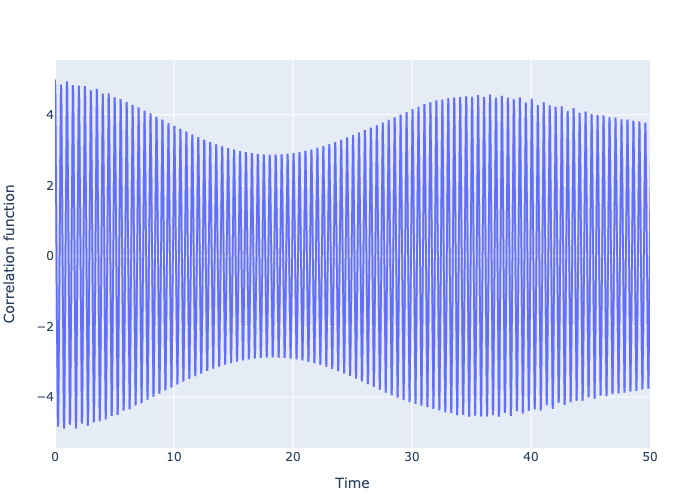

In [103]:
# plot the correlation function
corr_plot = scatter(x=tlist, y=real(corr_r), name="Correlation function")

layout = Layout(yaxis_title="Correlation function", xaxis_title="Time", xaxis=attr(range=[0, 50]))
plot([corr_plot], layout)

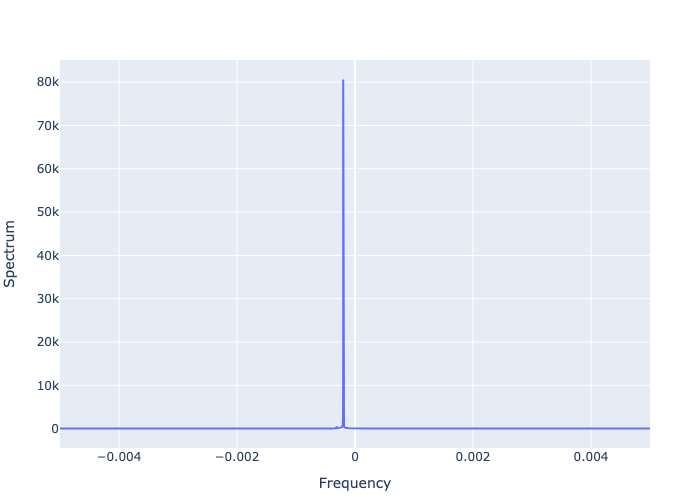

In [104]:
S = fftshift(fft(corr_r));

# plot the spectrum
f = fftshift(fftfreq(length(tlist), tlist[2] - tlist[1]))
S_plot = scatter(x=f, y=abs.(S), name="Spectrum")

layout = Layout(yaxis_title="Spectrum", xaxis_title="Frequency")

plot([S_plot], layout)

In [105]:
# repeat for qutrit modes
corr_qutrit = correlation_2op_1t(H3, ψ0, tlist, b, b');

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 00s (ETA: 0h 00m 00s)
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 21s (ETA: 0h 00m 00s)


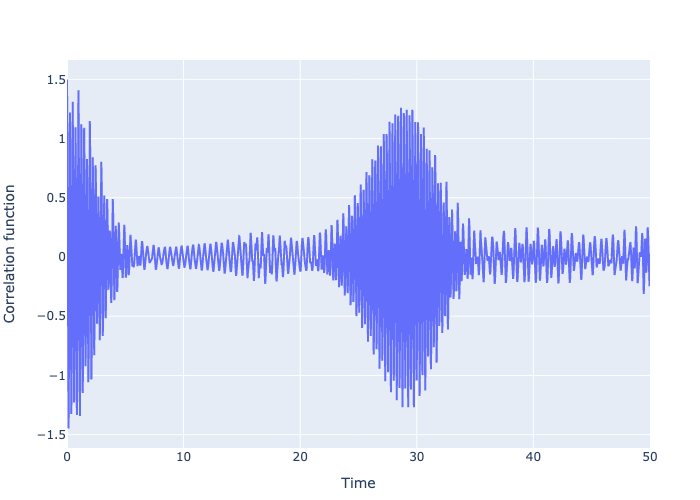

In [106]:
# plot the correlation function
corr_plot = scatter(x=tlist, y=real(corr_qutrit), name="Correlation function")

layout = Layout(yaxis_title="Correlation function", xaxis_title="Time", xaxis=attr(range=[0, 50]))

plot([corr_plot], layout)

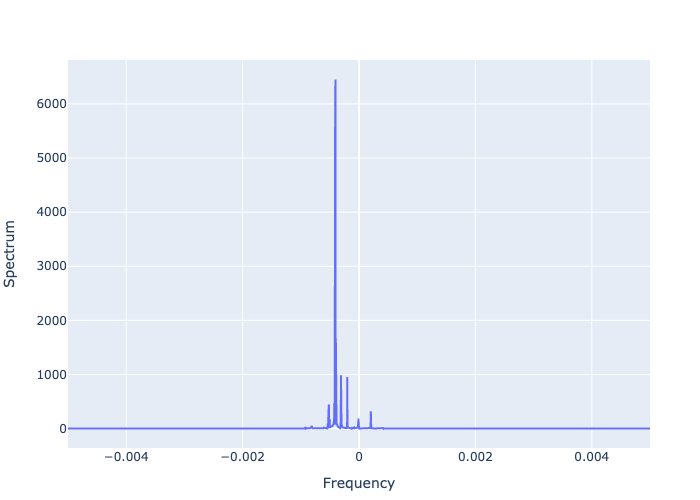

In [109]:
# get the spectrum of the qutrit and plot it
S = fftshift(fft(corr_qutrit));

f = fftshift(fftfreq(length(tlist), tlist[2] - tlist[1]))
S_plot = scatter(x=f, y=abs.(S), name="Spectrum")

layout = Layout(yaxis_title="Spectrum", xaxis_title="Frequency")

plot([S_plot], layout)

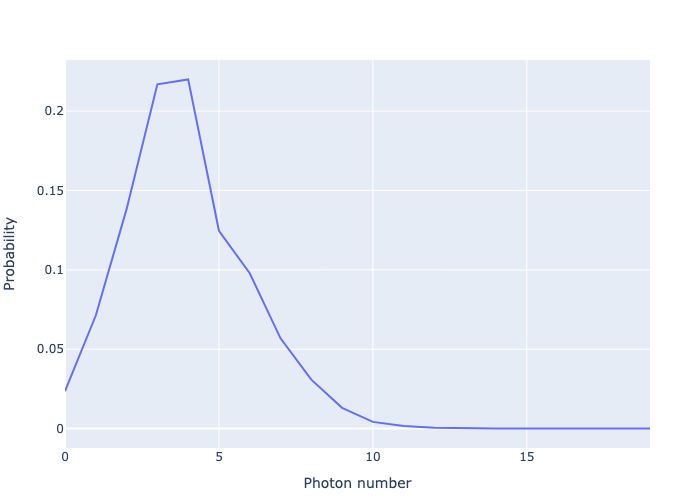

In [114]:
# get the partial trace of the cavity
ρ_qutrit = ptrace(result.states[end], 1)

# plot the diagonals of the density matrix
diag_plot = scatter(x=0:N-1, y=real(diag(ρ_qutrit)), name="Diagonal elements")

layout = Layout(yaxis_title="Probability", xaxis_title="Photon number")

plot([diag_plot], layout)

The similarity of this curve to the frequency spectrum of the qutrit is our fidelity. In this way we measure the cavity occupation numbers and get information on the state of the three-level system.

# Transmon readout

We now focus on the problem of transmon readout. We effective Hamiltonian is given by $H_{{tr}}$ and a time-dependent drive $H_d(t)$.

In [2]:
# set parameters for this section
const N = 20
const Ec = 2π*0.315 # GHz
const Ej = 51*Ec # GHz
const g = 2π*0.150 # GHz

const ωd = 2π*7.515 # GHz
const ϵd = 2π*0.180 # GHz
const κ = 2π*30/1000 # GHz

# hamiltonian for transmon readout 
b = destroy(N)

n0 = (Ej/4/Ec)^(1/4)
nt = n0 * 1im * (b' - b) / sqrt(2)
φ = 1/n0 * (b' + b) / sqrt(2)
H_transmon = 4*Ec * nt^2 - Ej*cos(φ)

# time-dependent part 
drive_op = 1im * (b' - b)
function H_drive(p, t)
    return p.ϵd * sin(p.ωd * t)
end

op = ((H_transmon, (drive_op, H_drive)));

In [3]:
# initial state is the ground state of the transmon
ψ0 = basis(N, 0)

# time span
tlist = 0:0.01:100

# expectation values
e_ops = [b' * b, nt, φ]

# run the simulation
result = mesolve(op, ψ0, tlist, [0*b], e_ops=e_ops, params=(ϵd=ϵd, ωd=ωd), saveat=tlist);

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 04s (ETA: 0h 00m 00s)


In [ ]:
# plot the state vs time
c0 = result.states

In [20]:
H_transmon_matrix = Matrix(H_transmon.data)
drive_op_matrix = Matrix(drive_op.data)

function drive_sin(t)
    ϵd * sin(ωd * t)
end

function f(du, u, p, t)
    # du .= -im * H3 * u - -im * g(t) * M2 * u
    mul!(du, H_transmon_matrix, u, -im, false)
    mul!(du, drive_op_matrix, u, -im * drive_sin(t), true)
end

u0 = ψ0.data

tspan = (0., 1)

prob = ODEProblem(f, u0, tspan, abstol=1e-7, reltol=1e-5)

sol = solve(prob, Tsit5());

In [21]:
# extract the c0 coefficients
ψ = sol.u
c0 = getindex.(ψ, 1);

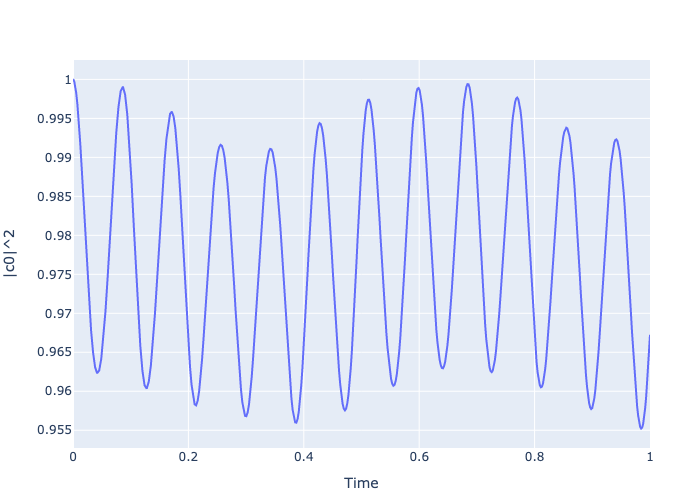

In [26]:
# plot it vs Time
plot_c0 = scatter(x=sol.t, y=abs.(c0), name="c0")

layout = Layout(yaxis_title="|c0|^2", xaxis_title="Time")

plot([plot_c0], layout)

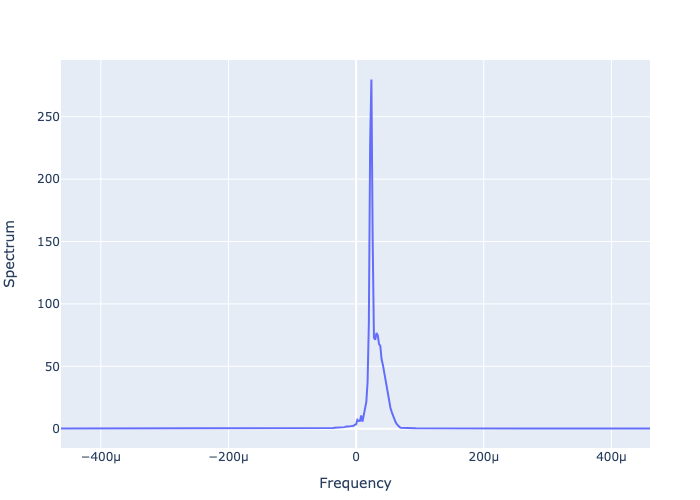

In [24]:
S = fft(c0)

S_plot = scatter(x=fftshift(fftfreq(length(sol.t), sol.t[2] - sol.t[1])), y=abs.(fftshift(S)), name="Spectrum")

layout = Layout(yaxis_title="Spectrum", xaxis_title="Frequency")

plot([S_plot], layout)

## Coupling to cat cavity

We now couple the cat qubit, represented by a storage mode $a$, to the transmon model $b$ via a capacitive tunable coupling $\lambda n_t n_c$ where $n_c$ is the cat mode's capacitive operator. Moreover, we drive the cat mode with a term $\propto \epsilon_d \sin(\omega_d) (a^{\dagger} - a)$. 

In [274]:
Na = 30
Nb = 4
a = tensor(destroy(Na), qeye(Nb))
ad = dag(a)
b = tensor(qeye(Na), destroy(Nb))
bd = dag(b)

function get_hamiltonian(a, b, ωr, EC, EJ, λ; cutoff=1)
    # time-independent part of transmon readout hamiltonian
    ad = dag(a)
    bd = dag(b)

    n0 = (EJ/4/EC)^(1/4)
    nt = n0 * 1im * (bd - b) / sqrt(2)
    φt = 1/n0 * (bd + b) / sqrt(2)

    H_transmon = 4*EC*nt^2 - EJ * sum((-1)^n / factorial(2*n) * (φt)^(2*n) for n in 0:cutoff)
    H_cat = ωr * ad * a

    # form of coupling
    # note that λ does not take into account the factors of the transmon but does for the cat
    H_coupling = λ * 1im * (ad - a) * nt

    H = H_transmon + H_cat + H_coupling
    return H, a, ad, b, bd
end;

function get_hamiltonian_bis(a, b, ωa, ωb, EJ, φa, φb, ϵp, ϵd, ωp, ωd; cutoff=1)
    # hamiltonian using critical cat paper + les houches derivation
    ad = dag(a)
    bd = dag(b)

    φ = φa * (ad + a) + φb * (bd + b)
    H = ωa * ad * a + ωb * bd * b - EJ * (cos(φ)+φ^2/2) 
    return H, a, ad, b, bd
end;

function H_drive(p, t)
    # time-dependent coefficient of the drive
    ϵd, ωd = p.ϵd, p.ωd
    H = ϵd * sin(ωd * t)
    return H
end

function H_drive_bis(p, t)
    ωp, ωd, ϵp, ϵd = p.ωp, p.ωd, p.ϵp, p.ϵd
    H = 2 * real(ϵp * exp(-1im * ωp * t) + ϵd * exp(-1im * ωd * t))
    return H
end;

In [277]:
# define the parameters
ωr = 7.5 # GHz --> negative detuning. 5.3 for positive detuning
EC = 2π*0.220 # GHz
EJ = 110*EC # GHz
λ = 2π*0.12 # GHz
ωd = 2π*7.515 # GHz --> negative detuning. 5.267 for positive detuning
ϵd = 2π*0.180 # GHz
κ = 2π*7.95/1000 # GHz

# define the non-linearity of transmon model
cutoff = 10 # highly non-linear, near-exact model
# cutoff = 1 # qho

# Define the parameters
# ωa = 1.0
# ωb = 1.0
# EJ = 1.0
# φa = 1.0
# φb = 1.0
# ϵp = 1.0
# ϵd = 1.0
# ωp = 1.0
# ωd = 1.0
# cutoff = 1

# get static part of hamiltonian
H_static, a, ad, b, bd = get_hamiltonian(a, b, ωr, EC, EJ, λ; cutoff=cutoff)
# H_static, a, ad, b, bd = get_hamiltonian_bis(a, b, ωa, ωb, EJ, φa, φb, ϵp, ϵd, ωp, ωd; cutoff=1)

cavity_n = 1im * (ad - a)
# Define the time-dependent Hamiltonian as a tuple
op = ((H_static, (cavity_n, H_drive)));


In [278]:
# initialize in the ground state of the transmon
# diagonalize the transmon hamitlonian for N = 80
N = 80
H = get_free_transmon_hamiltonian(N, EC, EJ; cutoff=cutoff)

# diagonalize the transmon hamiltonian
result = eigen(H)
ψ0t = result.vectors[:, 1]

# truncate the state at Nb 
ψ0t = Qobj(ψ0t[1:Nb]) # CONFIRM THIS STEP

# make initial state
ψ0 = basis(Na, 0) ⊗ ψ0t;

In [279]:
# Define the time span
tspan = 0:0.01:10

# Solve the master equation
result = mesolve(op, ψ0, tspan, [sqrt(κ)*a], e_ops=[a], params=(ϵd=ϵd, ωd=ωd), saveat=tspan)

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 01s (ETA: 0h 00m 00s)


Solution of time evolution
(return code: Success)
--------------------------
num_states = 1001
num_expect = 1
ODE alg.: OrdinaryDiffEqTsit5.Tsit5{typeof(OrdinaryDiffEqCore.trivial_limiter!), typeof(OrdinaryDiffEqCore.trivial_limiter!), Static.False}(OrdinaryDiffEqCore.trivial_limiter!, OrdinaryDiffEqCore.trivial_limiter!, static(false))
abstol = 1.0e-8
reltol = 1.0e-6


What does the state look like?

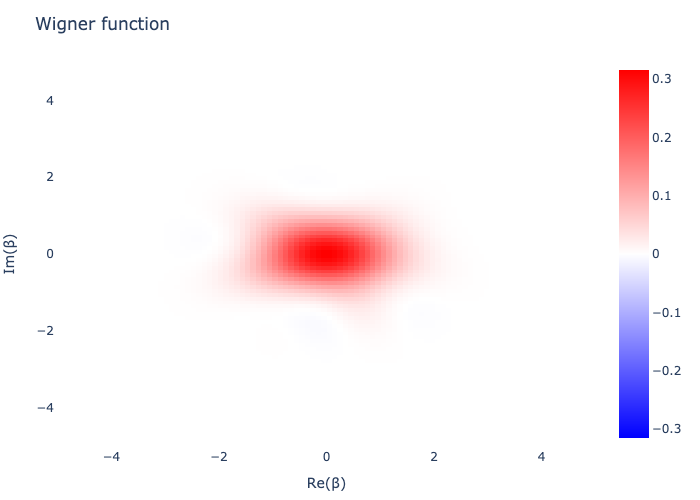

In [280]:
ψtest = result.states[end]
xvec = range(-5, 5, 100)

# plot the wigner function
plot_wigner(ψtest, xvec, xvec)


Look at the time evolution of the quadratures $X$ and $P$ which we find by taking the real and imaginary part, resp., of $\langle a\rangle = \alpha$.

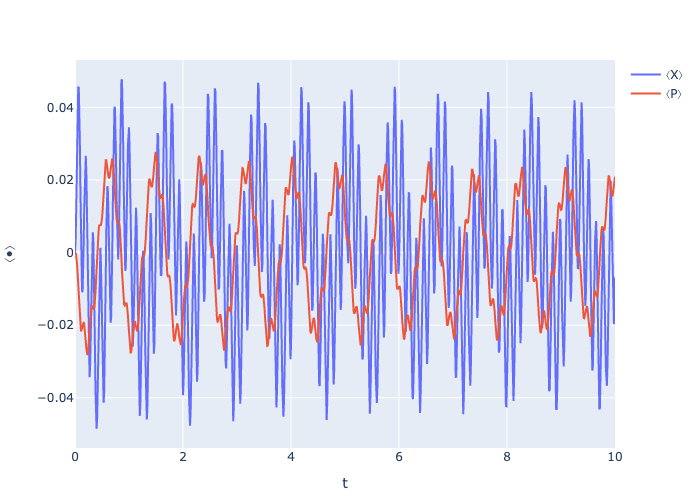

In [281]:
# plot the expectations value as a function of time
X_plot = scatter(x=tspan, y=real(result.expect)[:], name="⟨X⟩")
P_plot = scatter(x=tspan, y=imag(result.expect)[:], name="⟨P⟩")

# make appropriate layout
layout = Layout(
    yaxis_title="⟨•⟩",
    xaxis_title="t",
    width=1000,
    height=500
)

plot([X_plot, P_plot], layout)

Still want to modify the drive profile $\epsilon_d = \epsilon_d(t)$.

To proceed, let's add two-photon dissipation and make a cat qubit. This is done by applying a two-photon drive in the Hamiltonian along with the jump operator $a^2$. Effectively, we can just write the jump operator $a^2-\alpha^2$ where $\alpha = \sqrt{G/\eta}$, the two-photon drive and dissipation strengths.

In [282]:
# two-photon dissipation term
α = 2.5
κ2 = 1 # arbitrarily chosen
diss_jump = √κ2 * (a^2 - α^2)

# redo mesolve with the additional collapse operator
result = mesolve(op, ψ0, tspan, [sqrt(κ)*a, diss_jump], e_ops=[a], params=(ϵd=ϵd, ωd=ωd), saveat=tspan)

Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 03s (ETA: 0h 00m 00s)


Solution of time evolution
(return code: Success)
--------------------------
num_states = 1001
num_expect = 1
ODE alg.: OrdinaryDiffEqTsit5.Tsit5{typeof(OrdinaryDiffEqCore.trivial_limiter!), typeof(OrdinaryDiffEqCore.trivial_limiter!), Static.False}(OrdinaryDiffEqCore.trivial_limiter!, OrdinaryDiffEqCore.trivial_limiter!, static(false))
abstol = 1.0e-8
reltol = 1.0e-6


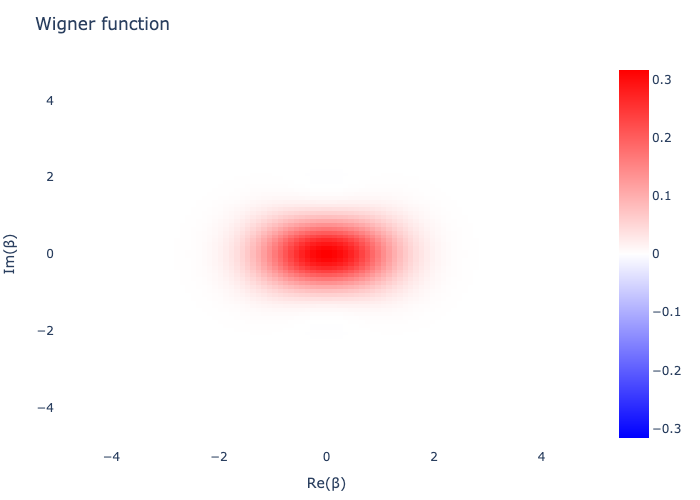

In [284]:
# plot the wigner function at the beginning to ensure a cat state
ψtest = result.states[1]
W = wigner(ψtest, xvec, xvec)

# plot it
plot_wigner(ψtest, xvec, xvec)

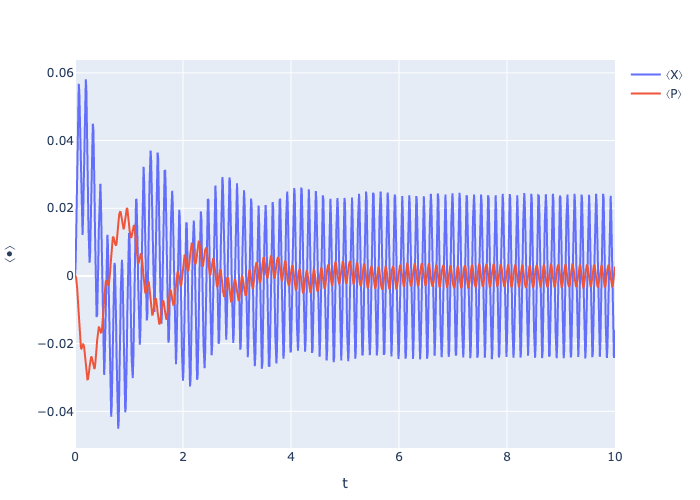

In [285]:
# plot the expectations value as a function of time
X_plot = scatter(x=tspan, y=real(result.expect)[:], name="⟨X⟩")
P_plot = scatter(x=tspan, y=imag(result.expect)[:], name="⟨P⟩")

# make appropriate layout
layout = Layout(
    yaxis_title="⟨•⟩",
    xaxis_title="t",
    width=1000,
    height=500
)

plot([X_plot, P_plot], layout)